<a href="https://colab.research.google.com/github/F1ameX/2025-ODS-NLP/blob/main/TUSUR_HW_9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Базовый вариант

In [ ]:
!pip install --quiet torchviz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 63.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 74.6 MB/s eta 0:00:00


In [ ]:
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torchvision.utils as vutils
from IPython.display import HTML
from kagglehub import kagglehub
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
from torchviz import make_dot

In [ ]:
dataroot = kagglehub.dataset_download("splcher/animefacedataset")
Image_Size = 64
batch_size = 128
lr = 0.0002
num_epochs=100
ngpu = 2

In [ ]:
dataset = ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(Image_Size),
                               transforms.CenterCrop(Image_Size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,shuffle=True)

In [ ]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [ ]:
device

device(type='cuda', index=0)

In [ ]:
def show_images(images):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(images.detach(), nrow=8).permute(1, 2, 0))

def show_batch(dl):
    for images, _ in dl:
        show_images(images)
        break

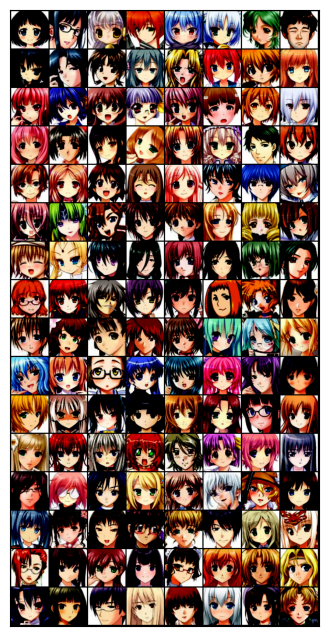

In [ ]:
show_batch(dataloader)

## Generator

Ниже реализован генератор на базе нейронной сети со свёрточными слоями. Архитектура DCGAN (Deep Convolutional GAN). Модель устроена следующим образом (сверху вниз):

Input: [batch_size, 100, 1, 1] (шум, 100-мерный вектор)

1. ConvTranspose2d (100 → 512)
    - Ядро: 4×4, stride=1, padding=0
    - Выход: [batch_size, 512, 4, 4]
    - BatchNorm2d(512)
    - ReLU()

2. ConvTranspose2d (512 → 256)
    - Ядро: 4×4, stride=2, padding=1
    - Выход: [batch_size, 256, 8, 8]
    - BatchNorm2d(256)
    - ReLU()

3. ConvTranspose2d (256 → 128)
    - Ядро: 4×4, stride=2, padding=1
    - Выход: [batch_size, 128, 16, 16]
    - BatchNorm2d(128)
    - ReLU()

4. ConvTranspose2d (128 → 64)
    - Ядро: 4×4, stride=2, padding=1
    - Выход: [batch_size, 64, 32, 32]
    - BatchNorm2d(64)
    - ReLU()

5. ConvTranspose2d (64 → 3)
    - Ядро: 4×4, stride=2, padding=1
    - Выход: [batch_size, 3, 64, 64] (финальное изображение)
    - Tanh()  (выходные пиксели в диапазоне [-1,1])

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(100, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( 64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( 64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d( 64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Формирование изображения модели схемы модели
generator = Generator(ngpu = torch.cuda.device_count())
input_tensor = torch.randn(1, 100, 1, 1)
output = generator(input_tensor)

dot = make_dot(output, params=dict(generator.named_parameters()))
dot.format = 'png'
dot.render('generator_model')

'generator_model.png'

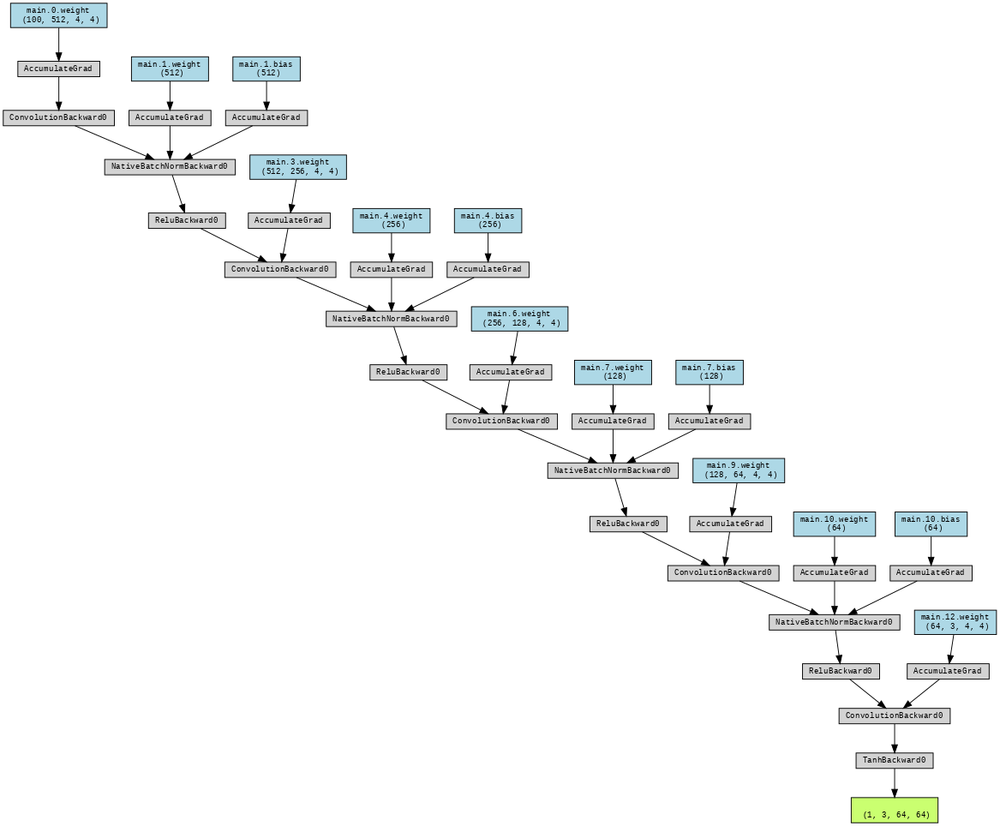

In [ ]:
print(torch.cuda.device_count())

1


In [ ]:
ngpu = torch.cuda.device_count()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

netG = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

print(netG)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Discriminator

Ниже реализован дискриминатор нашего GAN`a. Модель устроена следующим образом (сверху вниз):

Input: RGB-изображение [batch_size, 3, 64, 64]

1.	Conv2d (3 → 64)

	•	Ядро: 4×4, stride = 2, padding = 1

	•	Выход: [batch_size, 64, 32, 32]

	•	Активация: LeakyReLU (0.2)
(LeakyReLU нужна, чтобы сеть могла обучаться, избегая эффекта «умирающих нейронов».)

2.	Conv2d (64 → 128)

	•	Ядро: 4×4, stride = 2, padding = 1

	•	Выход: [batch_size, 128, 16, 16]

	•	BatchNorm2d(128)

	•	LeakyReLU (0.2)

3.	Conv2d (128 → 256)

	•	Ядро: 4×4, stride = 2, padding = 1

	•	Выход: [batch_size, 256, 8, 8]

	•	BatchNorm2d(256)

	•	LeakyReLU (0.2)

4.	Conv2d (256 → 512)

	•	Ядро: 4×4, stride = 2, padding = 1

	•	Выход: [batch_size, 512, 4, 4]

	•	BatchNorm2d(512)

	•	LeakyReLU (0.2)

5.	Conv2d (512 → 1)

	•	Ядро: 4×4, stride = 1, padding = 0

	•	Выход: [batch_size, 1, 1, 1]

	•	Sigmoid()

	•	Получается вероятность: число в интервале [0,1]


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
discriminator = Discriminator(ngpu = torch.cuda.device_count())
input_tensor = torch.randn(1, 100, 1, 1)
output = generator(input_tensor)

dot = make_dot(output, params=dict(generator.named_parameters()))
dot.format = 'png'
dot.render('discriminator')

'discriminator.png'

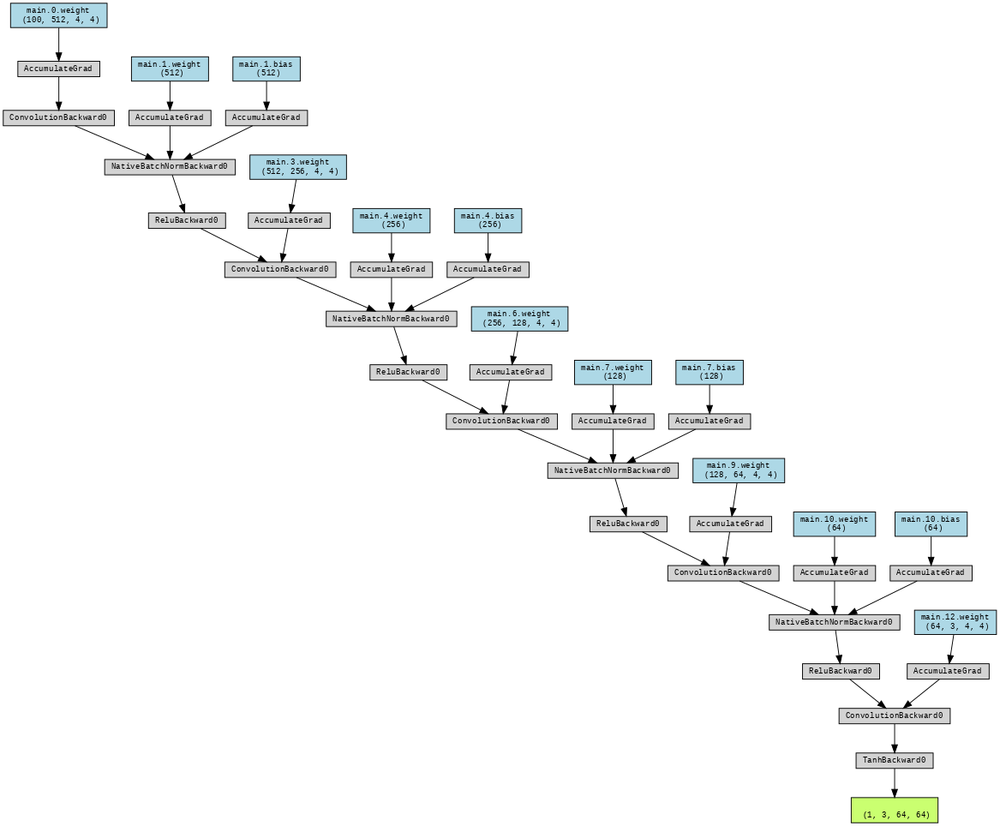

In [ ]:
netD = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Functions and Optimizers

In [ ]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, 100, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD = torch.optim.Adam(netD.parameters(), lr=lr)
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr)

## Training

In [ ]:

img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()


        noise = torch.randn(b_size, 100, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()


        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/497]	Loss_D: 1.5193	Loss_G: 2.5077	D(x): 0.5033	D(G(z)): 0.5514 / 0.0858
[0/100][50/497]	Loss_D: 0.0145	Loss_G: 9.2861	D(x): 0.9977	D(G(z)): 0.0120 / 0.0001
[0/100][100/497]	Loss_D: 0.0158	Loss_G: 10.4798	D(x): 0.9908	D(G(z)): 0.0052 / 0.0000
[0/100][150/497]	Loss_D: 0.0067	Loss_G: 11.9748	D(x): 0.9943	D(G(z)): 0.0007 / 0.0000
[0/100][200/497]	Loss_D: 0.0051	Loss_G: 10.9694	D(x): 0.9989	D(G(z)): 0.0040 / 0.0000
[0/100][250/497]	Loss_D: 0.0018	Loss_G: 13.2534	D(x): 0.9983	D(G(z)): 0.0001 / 0.0000
[0/100][300/497]	Loss_D: 0.0200	Loss_G: 16.3820	D(x): 0.9858	D(G(z)): 0.0001 / 0.0000
[0/100][350/497]	Loss_D: 0.0678	Loss_G: 8.2500	D(x): 0.9743	D(G(z)): 0.0063 / 0.0010
[0/100][400/497]	Loss_D: 0.0000	Loss_G: 21.5654	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[0/100][450/497]	Loss_D: 0.0194	Loss_G: 10.6874	D(x): 0.9989	D(G(z)): 0.0171 / 0.0001
[1/100][0/497]	Loss_D: 0.0206	Loss_G: 10.2614	D(x): 0.9859	D(G(z)): 0.0015 / 0.0001
[1/100][50/497]	Loss_D: 0.0034	Loss_

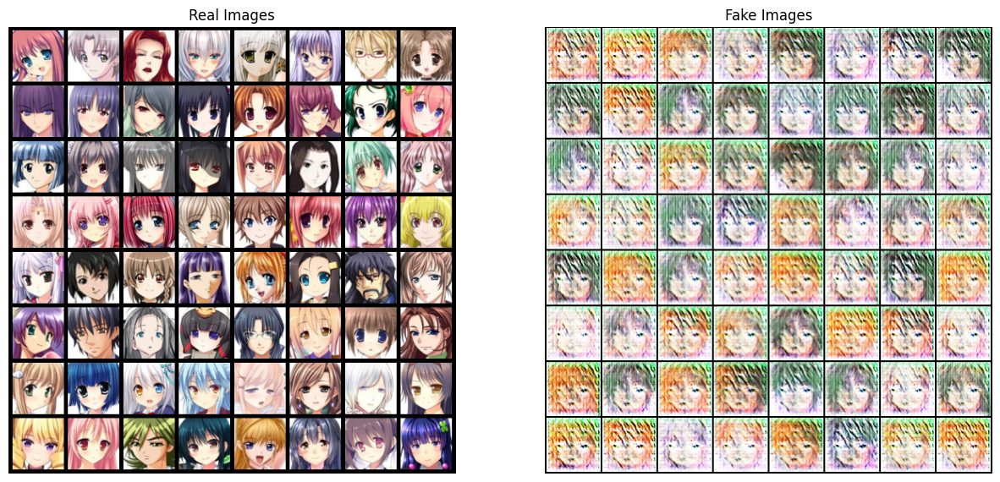

In [ ]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

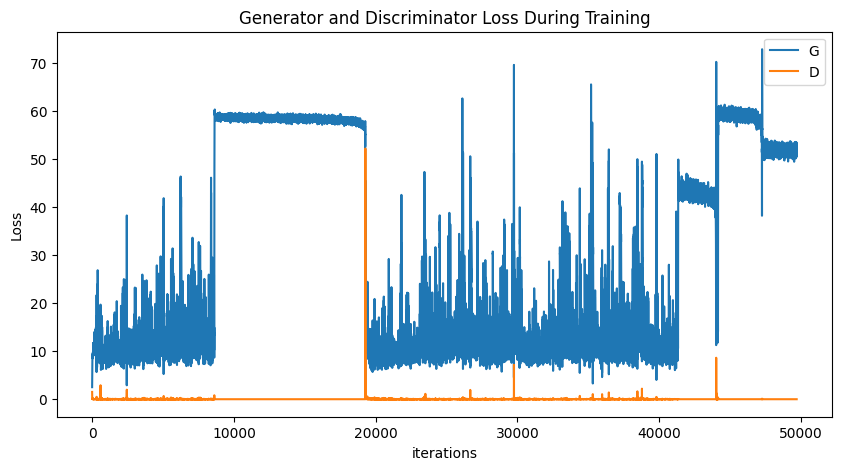

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

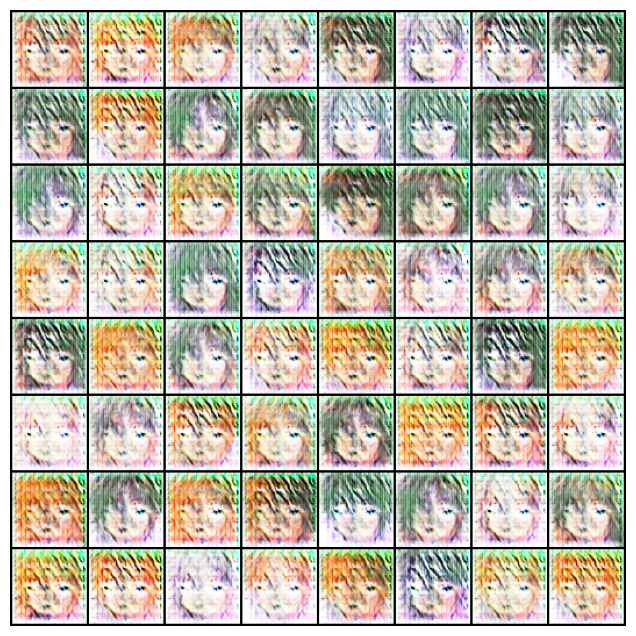

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Представленный GAN — это классический DCGAN (Deep Convolutional Generative Adversarial Network), состоящий из двух нейронных сетей:

---

**Генератор**

---

Генератор получает на вход случайный вектор («шум») размерности 100 и постепенно увеличивает его разрешение, используя ConvTranspose2d, BatchNorm и ReLU, в результате чего получается цветное изображение 3×64×64.

На последнем слое стоит активация Tanh, нормализующая выходные пиксели в диапазон от -1 до 1.

---

**Дискриминатор**

---

Дискриминатор принимает RGB-изображения размером 64×64 и постепенно уменьшает разрешение и увеличивает число каналов, используя свёртки (Conv2d). Его цель — выдать вероятность того, является ли изображение настоящим или фейковым.

Структура дискриминатора обратна генератору.

---

**Обучение**

---

Процесс обучения происходит следующим образом:

Дискриминатор учится отличать настоящие изображения от созданных генератором. Он максимизирует точность классификации изображений (реальное или фейковое).

Генератор, наоборот, учится обманывать дискриминатор, создавая реалистичные изображения из шума. Его цель — минимизировать вероятность того, что дискриминатор определит картинку как фейк.

Эти две сети конкурируют и улучшаются одновременно, это и есть основной принцип обучения GAN — соревновательное обучение.

На каждой итерации происходит следующее:

Дискриминатор получает настоящие и фейковые изображения, корректирует свои веса, чтобы лучше их отличать.

Генератор создаёт фейковые изображения, дискриминатор их оценивает. Генератор корректирует свои веса, чтобы дискриминатор ошибался чаще.

Со временем генератор создаёт всё более реалистичные изображения, которые дискриминатору становится сложнее отличить от реальных.


# Продвинутый вариант

**Продвинутый вариант:**

Здесь вам понадобится сделать свою модель и поиграться с ней (можно использовать этот же датасет или другой). Рекомендуется делать на kaggle, но нужа будет подписка, если есть желание получить ее, то в интернете есть много решений

## Подготовка данных

In [31]:
import numpy as np
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import DataLoader

In [32]:
BATCH_SIZE = 64
EPOCHS = 200

In [33]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

transform = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [34]:
dataset = torchvision.datasets.Places365(
    root = './data',
    split = 'train-standard',
    download = True,
    small = True,
    transform = transform
)

dataloader = DataLoader(dataset, batch_size = 64, shuffle = True)

In [35]:
import matplotlib.pyplot as plt
from torchvision.utils import make_grid

def plot_images(images):
  fig, ax = plt.subplots(figsize = (8, 8))
  ax.set_xticks([]); ax.set_yticks([])
  ax.imshow(make_grid(images.detach(), nrow=8).permute(1, 2, 0))

def plot_batch(batch):
  for images, _ in batch:
    plot_images(images)
    break

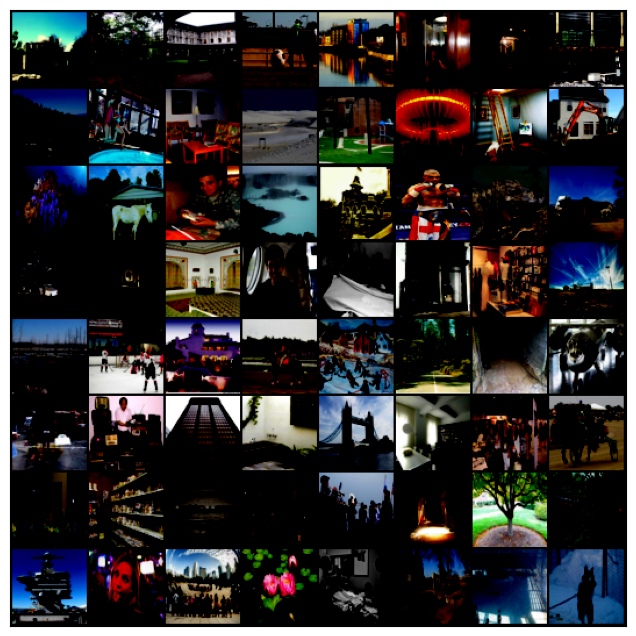

In [36]:
plot_batch(dataloader)

In [37]:
for image, label in dataloader:
  print(image.shape)
  print(label.shape)
  break

torch.Size([64, 3, 64, 64])
torch.Size([64])


## Архитектура DCGAN

In [60]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 1024, 4, 1, 0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),

            nn.ConvTranspose2d(1024, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.model(input)

In [61]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.model(input)

In [62]:
input_tensor = torch.randn(1, 100, 1, 1)
generator = Generator().to(device)
print(generator)

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()

In [63]:
discriminator = Discriminator().to(device)
print(discriminator)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Обучение

In [70]:
criterion = nn.BCELoss()

optimizerD = optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))
optimizerG = optim.Adam(generator.parameters(), lr=0.0003, betas=(0.5, 0.999))

real_label = 1
fake_label = 0
iterations = 0

img_list = []
lossG = []
lossD = []

fixed_noise = torch.randn(128, 100, 1, 1, device = device)

In [ ]:
for _e in range(EPOCHS):
  for idx, data in enumerate(dataloader, 0):

      discriminator.zero_grad()
      real_cpu = data[0].to(device)
      b_size = real_cpu.size(0)
      label = torch.full((b_size, ), real_label, dtype = torch.float, device = device)
      output = discriminator(real_cpu).view(-1)
      discriminator_real_error = criterion(output, label)
      discriminator_real_error.backward()
      discriminator_X = output.mean().item()

      noise = torch.randn(b_size, 100, 1, 1, device = device)
      fake = generator(noise)
      label.fill_(fake_label)
      output = discriminator(fake.detach()).view(-1)
      discriminator_fake_error = criterion(output, label)
      discriminator_fake_error.backward()
      discriminator_generator_z1 = output.mean().item()
      discriminator_error = discriminator_real_error + discriminator_fake_error
      optimizerD.step()

      generator.zero_grad()
      label.fill_(real_label)
      output = discriminator(fake).view(-1)
      generator_error = criterion(output, label)
      generator_error.backward()
      discriminator_generator_z2 = output.mean().item()
      optimizerG.step()

      lossG.append(generator_error.item())
      lossD.append(discriminator_error.item())

      if iterations % 50 == 0:
          print(f"[{_e}/{EPOCHS}][{idx}/{len(dataloader)}] Loss_D: {discriminator_error:.4f}, \
          Loss_G: {generator_error:.4f}, D(x): {discriminator_X:.4f}, D(G(z)): \
          {discriminator_generator_z1:.4f}/{discriminator_generator_z2:.4f}")

      iterations += 1

[0/200][0/28180] Loss_D: 0.1103,           Loss_G: 1.2861, D(x): 0.9233, D(G(z)):           0.0239/0.3427
[0/200][50/28180] Loss_D: 1.3488,           Loss_G: 1.0447, D(x): 0.5247, D(G(z)):           0.4811/0.3657
[0/200][100/28180] Loss_D: 1.4644,           Loss_G: 0.8713, D(x): 0.4841, D(G(z)):           0.5007/0.4297
[0/200][150/28180] Loss_D: 1.5855,           Loss_G: 0.7785, D(x): 0.4612, D(G(z)):           0.5368/0.4664
[0/200][200/28180] Loss_D: 1.3912,           Loss_G: 0.8974, D(x): 0.4914, D(G(z)):           0.4591/0.4198
[0/200][250/28180] Loss_D: 1.4044,           Loss_G: 0.8263, D(x): 0.4972, D(G(z)):           0.4881/0.4474
[0/200][300/28180] Loss_D: 1.5169,           Loss_G: 0.8549, D(x): 0.4732, D(G(z)):           0.5190/0.4355
[0/200][350/28180] Loss_D: 1.4693,           Loss_G: 0.9347, D(x): 0.4852, D(G(z)):           0.5102/0.4007
[0/200][400/28180] Loss_D: 1.3976,           Loss_G: 0.8553, D(x): 0.5233, D(G(z)):           0.4996/0.4391
[0/200][450/28180] Loss_D: 1.33